In [1]:
import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)
import os
import tempfile
import numpy as np
import pandas as pd
import csv
import string
import json
import tensorflow as tf
import pickle
import copy

import operator
import math

import matplotlib.pyplot as plt
import seaborn as sns

#Import Document Set
from gensim import corpora, models, similarities
#from gensim.models.phrases import Phrases, Phraser
from gensim.models import Doc2Vec
from gensim.models.doc2vec import TaggedDocument

import nltk
from nltk.util import ngrams
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize

from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.decomposition import PCA

import warnings
warnings.filterwarnings('ignore')

C:\Users\Victor\Anaconda3\envs\tensorflowCPU\lib\site-packages\gensim\utils.py:1209: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")
2019-03-05 10:55:13,288 : INFO : 'pattern' package not found; tag filters are not available for English


In [2]:
#Read a json file
def open_file(fname):
    with open(fname) as jsonfile:
            resumes = json.load(jsonfile)
    return resumes

In [3]:
def create_arr_by_skills(resumes):
    df=pd.DataFrame(resumes)
    job_desc=[]
    c=0
    for cv in df.Resume:
        puesto=cv["job"].lower()
    #     print(puesto)
        skill=""
        for skills in cv['skills_endorsment']:
            skill=skill+" "+skills['skill_name']+"\n"#.replace(" ","_")
        skill=skill.lower()
    #     print(skill)
    #         cat=skills['skill_category']
        if len(skill)>0:
            job_desc.append([puesto,skill])
            c=c+1
    print("Total CV's processed: {}".format(len(df.Resume)))
    print("Total CV's saved: {}".format(c))
    return job_desc   

# Jobs labeling Funtion 
def label_jobs(temp_file,job_desc):
    f= open(temp_file,"w+")
    jobs_labeled=[]
    documents=[]

    for job in job_desc:
        #Jobs Labeling
        if job[0].find("vice president")!= -1 or job[0].find("delivery manager")!= -1 or job[0].find(" vp ")!= -1 or job[0].find("svp ")!= -1:
            f.write("{} \t|\t vice president or equivalent\n".format(job[0]))
            label="vice president or equivalent"
        else :
            if job[0].find("president")!= -1:
                    f.write("{} \t|\t president or equivalent\n".format(job[0])) 
                    label="president or equivalent"
            else:            
                if job[0].find("director")!= -1:
                    f.write("{} \t|\t director or equivalent\n".format(job[0]))
                    label="director or equivalent"
                else:
                    if job[0].replace("sr","senior").find("senior project manager")!= -1 or (job[0].replace("sr","senior").find("senior")!= -1
                            and job[0].find("project manager")!= -1) or ( job[0].replace("programme","program").find("program")!= -1 and job[0].find("manager")!= -1):
                            f.write("{} \t|\t senior project manager or equivalent\n".format(job[0].replace("|",",")))
                            label="senior project manager or equivalent"
                    else:
                        if job[0].find("project manager")!= -1 or (job[0].find("project")!= -1 and job[0].replace("management","manager").find("manager")!= -1) or job[0].find("project coordinator")!= -1 or job[0].find("project consultant")!= -1 or (
                            job[0].find("manager")!= -1 ):
                            f.write("{} \t|\t project manager or equivalent\n".format(job[0].replace("|",",")))
                            label="project manager or equivalent"
                        else:
                            if job[0].find("leader")!= -1 or job[0].find("lead")!= -1:
                                f.write("{} \t|\t project leader or equivalent\n".format(job[0].replace("|",",")))
                                label="project leader or equivalent"
                            else:
                                if job[0].replace("sr","senior").find("senior")!= -1 or (job[0].find("technology")!= -1 and job[0].find("analyst")!= -1):
                                    f.write("{} \t|\t senior consultant or equivalent\n".format(job[0].replace("|",",")))
                                    label="senior consultant or equivalent"
                                else:
                                    if job[0].find("develop")!= -1 or job[0].find("system")!= -1 or job[0].find("tech")!= -1 or  job[0].find("analyst")!= -1 or  job[0].find("software")!= -1 or  job[0].find("it")!= -1 or  job[0].find("oracle")!= -1 or  job[0].find("consultant")!= -1 or  job[0].replace("jr","junior").find("junior")!= -1 or  job[0].find("engineer")!= -1:
                                        f.write("{} \t|\t it consultant or equivalent\n".format(job[0].replace("|",",")))
                                        label="it consultant or equivalent"
                                    else:
                                        f.write("{} \t|\t OOB\n".format(job[0].replace("|",",")))
                                        label="OOB"

        jobs_labeled.append([label,job[0],job[1].replace("\\n","\n").replace("   "," ").replace("  "," ").lower()])
    f.close()
    print("Archivo temporal creado en: {}".format(os.getcwd()))
    return documents,jobs_labeled

In [4]:
#Sentence tokenization 
def token_separation(sDescription="",bSentence=False,bStopwords=False):
    
    sentenceTkn = []
    
    #Use of stopwords
    stoplist = []
    if stopwords:
        stoplist = list(set(stopwords.words('english')))
        stoplist.extend(["–","/","&",".","$","(",")","!","?",";",":","'",","])
    
    #Convert Description to sentence and Tokenization of words
    tnzr = nltk.tokenize
    if bSentence:
        sentences= sDescription.split("\n")
        for sen in sentences:
            tnkstr= tnzr.word_tokenize(sen)
            lSenTkn=[word for word in tnkstr if (word not in stoplist)]
            if len(lSenTkn)>0:
                sentenceTkn.append(lSenTkn)
    else:
        sentences = sDescription
        tnkstr= tnzr.word_tokenize(sentences)   
        sentenceTkn = [word for word in tnkstr if (word not in stoplist)]

    return sentenceTkn

In [5]:
# Definition of the paths to be used
fpath= os.getcwd()
fname= 'C:\\Users\\Victor\\Documents\\LinkedIn Input/LinkedinCV(300)_2.json'
# fmodelname = os.path.join(fpath,'Model/Doc2vecForSkill.model')
temp_file='JobsLabeledSk.txt'

In [6]:
resumes = open_file(fname)
job_desc = create_arr_by_skills(resumes)
_,jobs_labeled = label_jobs(temp_file,job_desc)

Total CV's processed: 300
Total CV's saved: 293
Archivo temporal creado en: C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding


In [7]:
 token_separation(jobs_labeled[0][2],bSentence=True,bStopwords=True)

[['python'],
 ['c++'],
 ['opengl'],
 ['computer', 'vision'],
 ['algorithms'],
 ['computer', 'science'],
 ['machine', 'learning'],
 ['data', 'analysis'],
 ['data', 'visualization'],
 ['software', 'design'],
 ['science'],
 ['computer', 'graphics'],
 ['3d', 'visualization'],
 ['big', 'data'],
 ['object', 'oriented', 'design'],
 ['shell', 'scripting'],
 ['web', 'services'],
 ['climate', 'change'],
 ['web', 'development'],
 ['proposal', 'writing'],
 ['social', 'media'],
 ['java'],
 ['javascript'],
 ['jquery', 'ui'],
 ['jquery'],
 ['android'],
 ['high', 'performance', 'computing'],
 ['parallel', 'computing'],
 ['vtk'],
 ['scientific', 'computing'],
 ['cmake'],
 ['mpi'],
 ['qt'],
 ['virtual', 'reality'],
 ['opengl', 'es'],
 ['data', 'science'],
 ['geoprocessing'],
 ['geovisualization'],
 ['paraview'],
 ['gdal'],
 ['webgl'],
 ['geographic', 'information', 'science'],
 ['scientific', 'data', 'management'],
 ['data', 'analytics'],
 ['big', 'data', 'analytics'],
 ['unix', 'shell', 'scripting']]

In [9]:
#Tagged Documents
jobSentnc_tkn = []
documents = []
for d in jobs_labeled:
    jobSentnc_tkn.append([d[0],d[1],token_separation(d[2],bSentence=True,bStopwords=True)])
#     documents.append(TaggedDocument(token_separation(d[2],bStopwords=True),[d[0].replace(" ","_")]))

In [10]:
jobSentnc_tkn

[['project manager or equivalent',
  'project manager',
  [['python'],
   ['c++'],
   ['opengl'],
   ['computer', 'vision'],
   ['algorithms'],
   ['computer', 'science'],
   ['machine', 'learning'],
   ['data', 'analysis'],
   ['data', 'visualization'],
   ['software', 'design'],
   ['science'],
   ['computer', 'graphics'],
   ['3d', 'visualization'],
   ['big', 'data'],
   ['object', 'oriented', 'design'],
   ['shell', 'scripting'],
   ['web', 'services'],
   ['climate', 'change'],
   ['web', 'development'],
   ['proposal', 'writing'],
   ['social', 'media'],
   ['java'],
   ['javascript'],
   ['jquery', 'ui'],
   ['jquery'],
   ['android'],
   ['high', 'performance', 'computing'],
   ['parallel', 'computing'],
   ['vtk'],
   ['scientific', 'computing'],
   ['cmake'],
   ['mpi'],
   ['qt'],
   ['virtual', 'reality'],
   ['opengl', 'es'],
   ['data', 'science'],
   ['geoprocessing'],
   ['geovisualization'],
   ['paraview'],
   ['gdal'],
   ['webgl'],
   ['geographic', 'information', 

In [11]:
#Infering sentences
def infer_doc2vec(model_name,jobs_labeled):
    model = model_name

    lbl=[]
    emb=[]
#     print(jobs_labeled)
    for job in jobs_labeled:
        model.random.seed(0)
#         print(job)
#         print(job[2])
        vecjob = model.infer_vector(doc_words=job)#, steps=20, alpha=0.025)
#         lbl.append(job[0:2])
        emb.append(vecjob)
    
    docs_emb = {"Labels": lbl
               ,"Embedding": np.array(emb)}
    
    return emb

In [12]:
fpath= os.getcwd()
fmodelname = os.path.join(fpath,'Model/Doc2vecForSentences.model')
model = Doc2Vec.load(fmodelname)

2019-03-05 10:55:42,875 : INFO : loading Doc2Vec object from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSentences.model
2019-03-05 10:55:43,162 : INFO : loading trainables recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSentences.model.trainables.* with mmap=None
2019-03-05 10:55:43,162 : INFO : loading wv recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSentences.model.wv.* with mmap=None
2019-03-05 10:55:43,162 : INFO : loading vocabulary recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSentences.model.vocabulary.* with mmap=None
2019-03-05 10:55:43,162 : INFO : loading docvecs recursively from C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vecForSentences.model.docvecs.* with mmap=None
2019-03-05 10:55:43,162 : INFO : loaded C:\Users\Victor\Documents\Seq2Seq\Samples\SentenceEmbedding\Model/Doc2vec

In [13]:
jobSentence = jobSentnc_tkn

In [14]:
jobSenD2V=[]
for js in jobSentence:
#     print(js)
    eSenbyDes=infer_doc2vec(model,js[2])
    jobSenD2V.append([js[0],js[1],js[2],eSenbyDes])    
#     break;   

In [15]:
jobSenD2V

[['project manager or equivalent',
  'project manager',
  [['python'],
   ['c++'],
   ['opengl'],
   ['computer', 'vision'],
   ['algorithms'],
   ['computer', 'science'],
   ['machine', 'learning'],
   ['data', 'analysis'],
   ['data', 'visualization'],
   ['software', 'design'],
   ['science'],
   ['computer', 'graphics'],
   ['3d', 'visualization'],
   ['big', 'data'],
   ['object', 'oriented', 'design'],
   ['shell', 'scripting'],
   ['web', 'services'],
   ['climate', 'change'],
   ['web', 'development'],
   ['proposal', 'writing'],
   ['social', 'media'],
   ['java'],
   ['javascript'],
   ['jquery', 'ui'],
   ['jquery'],
   ['android'],
   ['high', 'performance', 'computing'],
   ['parallel', 'computing'],
   ['vtk'],
   ['scientific', 'computing'],
   ['cmake'],
   ['mpi'],
   ['qt'],
   ['virtual', 'reality'],
   ['opengl', 'es'],
   ['data', 'science'],
   ['geoprocessing'],
   ['geovisualization'],
   ['paraview'],
   ['gdal'],
   ['webgl'],
   ['geographic', 'information', 

In [16]:
pmD2V = []
for jse in jobSenD2V:
    if jse[0].find("project manager or equivalent")!= -1 and jse[0].find("senior project manager or equivalent")== -1:
        pmD2V.append(jse[0:4])

In [17]:
#Verify the total of sentences by job posititon
# c=0
sent2Vec=[]
for pms in pmD2V:
#     c=c+len(pms[2])
    for s in zip(pms[2],pms[3]):
        sent2Vec.append([" ".join(s[0]),s[1]])
#     break
print("Total number of sentences: {}".format(len(sent2Vec)))

Total number of sentences: 2076


In [19]:
def dot_product(v1, v2):
    return sum(map(operator.mul, v1, v2))

def simil_cos(v1, v2):
    prod = dot_product(v1, v2)
    len1 = math.sqrt(dot_product(v1, v1))
    len2 = math.sqrt(dot_product(v2, v2))
    return prod / (len1 * len2)

#Cosine Similarity calculation
cosineMatS2V= np.zeros((len(sent2Vec),len(sent2Vec)))

#Validation
# for i,z in enumerate(sentEmb):
#     if i == 3:
#         break
#     print (z[0])
# print("#########################")

for x,s1 in enumerate(sent2Vec):
#     if x==3: break
    for y,s2 in enumerate(sent2Vec):
#         print(y)
#         if y==3: break
        sim= round(simil_cos(s1[1],s2[1]),4)
        cosineMatS2V[x][y]=sim
#         print("sentence 1:{}".format(s1[0]))
#         print("sentence 2:{}".format(s2[0]))
#         print("similarity:{}".format(sim))
#         print ("************\n")   

In [20]:
dfCos = pd.DataFrame(cosineMatS2V,columns=[s[0] for s in sent2Vec])
dfCos

,python,c++,opengl,computer vision,algorithms,computer science,machine learning,data analysis,data visualization,software design,...,illustrator,xhtml,sql server,management,leadership,webcasting,dhtml,coldfusion,front-end,hosting
0,1.0000,0.6807,-0.0263,0.6347,0.6775,0.7110,0.6251,0.4728,0.5227,0.6426,...,0.5641,0.6152,0.6876,0.4272,0.5757,0.0299,0.5899,0.6703,0.7036,0.7861
1,0.6807,1.0000,-0.0716,0.4985,0.5840,0.5781,0.6140,0.3731,0.4465,0.5390,...,0.5233,0.2808,0.6056,0.5112,0.5694,0.0706,0.2976,0.5845,0.5950,0.7088
2,-0.0263,-0.0716,1.0000,0.0252,-0.0241,-0.0482,-0.0900,-0.0333,-0.0106,-0.0522,...,0.0035,0.0101,0.0399,0.0475,-0.0628,-0.0133,-0.0069,0.0863,-0.0408,-0.0273
3,0.6347,0.4985,0.0252,1.0000,0.6100,0.8129,0.5263,0.4059,0.5115,0.4532,...,0.2895,0.5203,0.5272,0.5467,0.5562,0.0079,0.4982,0.5128,0.5880,0.5625
4,0.6775,0.5840,-0.0241,0.6100,1.0000,0.6050,0.5929,0.5214,0.4787,0.6446,...,0.4358,0.4999,0.6255,0.5987,0.5805,0.0799,0.5603,0.5008,0.7300,0.6102
5,0.7110,0.5781,-0.0482,0.8129,0.6050,1.0000,0.6310,0.4497,0.5660,0.5648,...,0.4777,0.5131,0.6316,0.5562,0.6021,0.0394,0.5329,0.5503,0.5734,0.6662
6,0.6251,0.6140,-0.0900,0.5263,0.5929,0.6310,1.0000,0.4331,0.5456,0.5479,...,0.6143,0.3803,0.5930,0.5072,0.5929,0.0639,0.3635,0.5675,0.7029,0.6627
7,0.4728,0.3731,-0.0333,0.4059,0.5214,0.4497,0.4331,1.0000,0.7608,0.4720,...,0.3216,0.3919,0.4529,0.4467,0.3935,0.1026,0.3489,0.3764,0.5504,0.4236
8,0.5227,0.4465,-0.0106,0.5115,0.4787,0.5660,0.5456,0.7608,1.0000,0.4736,...,0.4824,0.4328,0.4272,0.4731,0.3984,0.0115,0.3986,0.4174,0.4975,0.5263
9,0.6426,0.5390,-0.0522,0.4532,0.6446,0.5648,0.5479,0.4720,0.4736,1.0000,...,0.3962,0.2864,0.5619,0.5255,0.4849,0.0670,0.2746,0.4984,0.5056,0.5125


In [21]:
fprepath= os.path.join(fpath,"Preprocessing/")
dfCos.to_csv(os.path.join(fprepath,"SimCosMatrix_Skilldesctraining.csv"))

In [22]:
def euclideanDist(x,y):   
    return np.sqrt(np.sum((x-y)**2))

In [23]:
#Euclidean distance calculation
EuclideanMatS2V= np.zeros((len(sent2Vec),len(sent2Vec)))

for x,s1 in enumerate(sent2Vec):
    for y,s2 in enumerate(sent2Vec):
        dist= round(euclideanDist(s1[1],s2[1]),4)
        EuclideanMatS2V[x][y]=dist

In [24]:
dfEucDist = pd.DataFrame(EuclideanMatS2V,columns=[s[0] for s in sent2Vec])
dfEucDist

,python,c++,opengl,computer vision,algorithms,computer science,machine learning,data analysis,data visualization,software design,...,illustrator,xhtml,sql server,management,leadership,webcasting,dhtml,coldfusion,front-end,hosting
0,0.0000,3.2049,3.9405,4.0986,3.1815,3.5304,4.0507,4.5034,4.2426,3.6516,...,3.9034,3.7419,3.7245,3.7448,3.7572,3.9393,3.8688,3.3045,3.0517,2.5785
1,3.2049,0.0000,4.0770,4.7757,3.6761,4.2417,4.1345,4.9606,4.6168,4.1826,...,4.1366,5.1608,4.1731,3.5832,3.8421,4.0741,5.1101,3.7641,3.6284,3.0621
2,3.9405,4.0770,0.0000,5.2443,3.9832,4.9904,5.1012,4.7322,4.6515,4.5875,...,4.3798,4.5106,5.0934,2.8373,4.2029,0.0286,4.5260,4.1786,3.9872,3.9443
3,4.0986,4.7757,5.2443,0.0000,4.2291,3.1396,5.0356,5.4544,4.9177,5.1709,...,5.7785,4.8206,5.0286,4.3917,4.5440,5.2446,4.9335,4.7430,4.3372,4.4489
4,3.1815,3.6761,3.9832,4.2291,0.0000,4.0879,4.2168,4.3127,4.4453,3.6533,...,4.4543,4.2715,4.0534,3.2222,3.7532,3.9812,4.0181,4.0818,2.9282,3.4993
5,3.5304,4.2417,4.9904,3.1396,4.0879,0.0000,4.3343,5.1039,4.5010,4.4811,...,4.8163,4.7056,4.3287,4.1469,4.1596,4.9886,4.6160,4.4059,4.2395,3.7724
6,4.0507,4.1345,5.1012,5.0356,4.2168,4.3343,0.0000,5.2432,4.6644,4.6270,...,4.2128,5.3716,4.5984,4.4020,4.2718,5.0981,5.4506,4.3912,3.6494,3.8603
7,4.5034,4.9606,4.7322,5.4544,4.3127,5.1039,5.2432,0.0000,3.2458,4.7894,...,5.3140,5.0994,5.1485,4.2948,4.9390,4.7296,5.2845,4.9973,4.1850,4.7046
8,4.2426,4.6168,4.6515,4.9177,4.4453,4.5010,4.6644,3.2458,0.0000,4.7393,...,4.6001,4.8807,5.2286,4.1470,4.8700,4.6510,5.0332,4.7831,4.3676,4.2283
9,3.6516,4.1826,4.5875,5.1709,3.6533,4.4811,4.6270,4.7894,4.7393,0.0000,...,4.9295,5.4343,4.5529,3.9256,4.4722,4.5851,5.4879,4.4042,4.2940,4.2485


In [25]:
fprepath= os.path.join(fpath,"Preprocessing/")
dfEucDist.to_csv(os.path.join(fprepath,"EucDistMatrix_Skilldesctraining.csv"))

In [26]:
#Convert coordinates cartesian to polar coordinates
def cart2pol(x, y):
    rho = np.sqrt(x**2 + y**2) #radious
    phi = np.arctan2(y, x)     #angle
    return [rho, phi]

In [27]:
jsenemb=[]
jsenskill=[]
for js in sent2Vec:
#     for tkn in js[1]:
        jsenemb.append(js[1])  
#     for tk in js[0]:
        jsenskill.append(js[0])

In [28]:
goldStandardEmb = []
goldStandardLbl = []
print(jsenskill[346])
goldStandardEmb.append(jsenemb[346])
goldStandardLbl.append(jsenskill[346])
print(jsenskill[494])
goldStandardEmb.append(jsenemb[494])
goldStandardLbl.append(jsenskill[494])
print(jsenskill[532])
goldStandardEmb.append(jsenemb[532])
goldStandardLbl.append(jsenskill[532])
print(jsenskill[427])
goldStandardEmb.append(jsenemb[427])
goldStandardLbl.append(jsenskill[427])
print(jsenskill[537])
goldStandardEmb.append(jsenemb[537])
goldStandardLbl.append(jsenskill[537])
print(jsenskill[542])
goldStandardEmb.append(jsenemb[542])
goldStandardLbl.append(jsenskill[542])
print(jsenskill[1307])
goldStandardEmb.append(jsenemb[1307])
goldStandardLbl.append(jsenskill[1307])
print(jsenskill[1208])
goldStandardEmb.append(jsenemb[1208])
goldStandardLbl.append(jsenskill[1208])
print(jsenskill[1364])
goldStandardEmb.append(jsenemb[1364])
goldStandardLbl.append(jsenskill[1364])
print(jsenskill[1547])
goldStandardEmb.append(jsenemb[1547])
goldStandardLbl.append(jsenskill[1547])
print(jsenskill[540])
goldStandardEmb.append(jsenemb[540])
goldStandardLbl.append(jsenskill[540])
print(jsenskill[1039])
goldStandardEmb.append(jsenemb[1039])
goldStandardLbl.append(jsenskill[1039])

agile methodologies
analytical skills
consulting
interpersonal skills
leadership
management
negotiation
organization
presentation skills
sdlc
strategic partnerships
teamwork


In [29]:
#Cosine Similarity calculation
cosineMatrixGoldS= np.zeros((len(goldStandardEmb),len(goldStandardEmb)))
eucDistMatrixGoldS= np.zeros((len(goldStandardEmb),len(goldStandardEmb)))
canDistMatrixGoldS= np.zeros((len(goldStandardEmb),len(goldStandardEmb)))

for x,s1 in enumerate(goldStandardEmb):
    for y,s2 in enumerate(goldStandardEmb):
        sim= round(simil_cos(s1,s2),8)
        cosineMatrixGoldS[x][y]=sim
        
for x,s1 in enumerate(goldStandardEmb):
    for y,s2 in enumerate(goldStandardEmb):
        sim= round(euclideanDist(s1,s2),8)
        eucDistMatrixGoldS[x][y]=sim

for x,s1 in enumerate(goldStandardEmb):
    for y,s2 in enumerate(goldStandardEmb):
        sim= round(euclideanDist(s1,s2),8)
        canDistMatrixGoldS[x][y]=sim

In [30]:
dfCosGS = pd.DataFrame(cosineMatrixGoldS,columns=[s for s in goldStandardLbl])
dfCosGS

,agile methodologies,analytical skills,consulting,interpersonal skills,leadership,management,negotiation,organization,presentation skills,sdlc,strategic partnerships,teamwork
0,1.000000,0.658747,0.663930,0.666380,0.551576,0.630014,0.690519,0.588177,0.612676,0.748121,0.594110,0.656376
1,0.658747,1.000000,0.698618,0.867344,0.656286,0.646916,0.642379,0.668867,0.860386,0.712267,0.670856,0.721937
2,0.663930,0.698618,1.000000,0.704701,0.644639,0.602393,0.703893,0.689738,0.701028,0.658210,0.596493,0.724736
3,0.666380,0.867344,0.704701,1.000000,0.629710,0.632513,0.688933,0.692519,0.884119,0.756403,0.646078,0.677717
4,0.551576,0.656286,0.644639,0.629710,1.000000,0.596579,0.617913,0.733526,0.665290,0.603472,0.646062,0.665471
5,0.630014,0.646916,0.602393,0.632513,0.596579,1.000000,0.660482,0.599398,0.646857,0.552786,0.682369,0.489316
6,0.690519,0.642379,0.703893,0.688933,0.617913,0.660482,1.000000,0.726919,0.673214,0.700315,0.614560,0.727543
7,0.588177,0.668867,0.689738,0.692519,0.733526,0.599398,0.726919,1.000000,0.635471,0.582271,0.751221,0.701767
8,0.612676,0.860386,0.701028,0.884119,0.665290,0.646857,0.673214,0.635471,1.000000,0.684137,0.640312,0.708534
9,0.748121,0.712267,0.658210,0.756403,0.603472,0.552786,0.700315,0.582271,0.684137,1.000000,0.590048,0.694688


In [31]:
dfEucDistGS = pd.DataFrame(eucDistMatrixGoldS,columns=[s for s in goldStandardLbl])
dfEucDistGS

,agile methodologies,analytical skills,consulting,interpersonal skills,leadership,management,negotiation,organization,presentation skills,sdlc,strategic partnerships,teamwork
0,0.000000,4.259218,3.954465,4.204422,4.565243,4.098158,3.800804,4.343619,4.543480,3.482293,4.673808,3.983897
1,4.259218,0.000000,3.649771,2.601615,3.918188,3.883149,3.927684,3.815899,2.678034,3.582348,4.134089,3.511254
2,3.954465,3.649771,0.000000,3.604235,3.460562,3.218820,3.030087,3.159763,3.646068,3.335780,4.222095,2.936226
3,4.204422,2.601615,3.604235,0.000000,4.048641,3.920424,3.675876,3.675874,2.435469,3.307617,4.279181,3.740432
4,4.565243,3.918188,3.460562,4.048641,0.000000,3.388218,3.541617,3.007565,3.878146,3.685449,4.014487,3.330021
5,4.098158,3.883149,3.218820,3.920424,3.388218,0.000000,2.921515,3.250403,3.896282,3.443199,3.807526,3.537278
6,3.800804,3.927684,3.030087,3.675876,3.541617,2.921515,0.000000,2.922194,3.780817,3.080627,4.110052,2.875054
7,4.343619,3.815899,3.159763,3.675874,3.007565,3.250403,2.922194,0.000000,3.999967,3.700722,3.390001,3.068367
8,4.543480,2.678034,3.646068,2.435469,3.878146,3.896282,3.780817,3.999967,0.000000,3.750088,4.328013,3.596020
9,3.482293,3.582348,3.335780,3.307617,3.685449,3.443199,3.080627,3.700722,3.750088,0.000000,4.270981,3.123899


In [32]:
fprepath= os.path.join(fpath,"Preprocessing/")
dfCosGS.to_csv(os.path.join(fprepath,"SimCosMatGoldStandardSkilldesctrained.csv"))
dfEucDistGS.to_csv(os.path.join(fprepath,"EucDistMatGoldStandardSkilldesctrained.csv"))

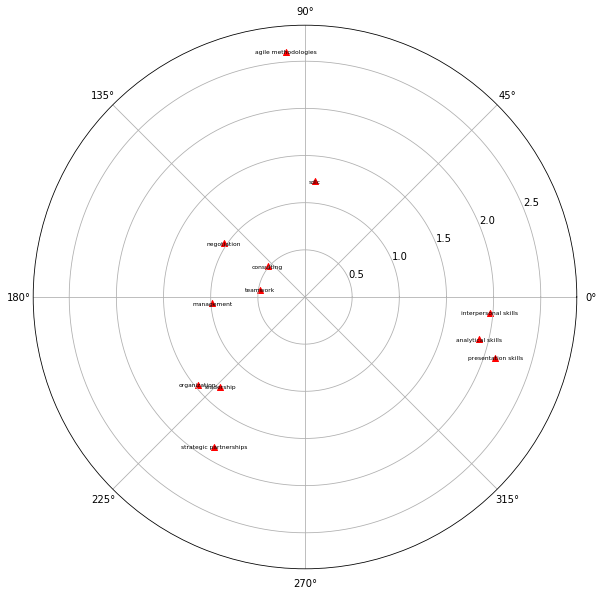

In [33]:
pca = PCA(n_components=2).fit(goldStandardEmb)
datapoint = pca.transform(goldStandardEmb)

polars=[]
for point in datapoint:
    polar = cart2pol(point[0], point[1])
#     print(polar)
    polars.append(polar)
#     break

r=[]
theta=[]
for cp in polars:
    r.append(cp[0])
    theta.append(cp[1])
    
fig = plt.figure(figsize=(20,10))
ax= fig.add_subplot(111,projection='polar')
ax.set_rmax(0.012)
c = ax.scatter(theta, r,c="r",marker="^")
plt.rcParams.update({'font.size': 6})
for i, p in enumerate(goldStandardLbl):
    ax.annotate(p,xy=(theta[i],r[i]),horizontalalignment='center',
            verticalalignment='center')
fig.show()

plt.savefig(os.path.join(fprepath,"polar_GS_SkillDescTrained") + '.png', dpi = 300)

Metric: cosine
Eps: 0.12
Min Samples: 2
Estimated number of clusters: 262
Estimated number of noise points: 400


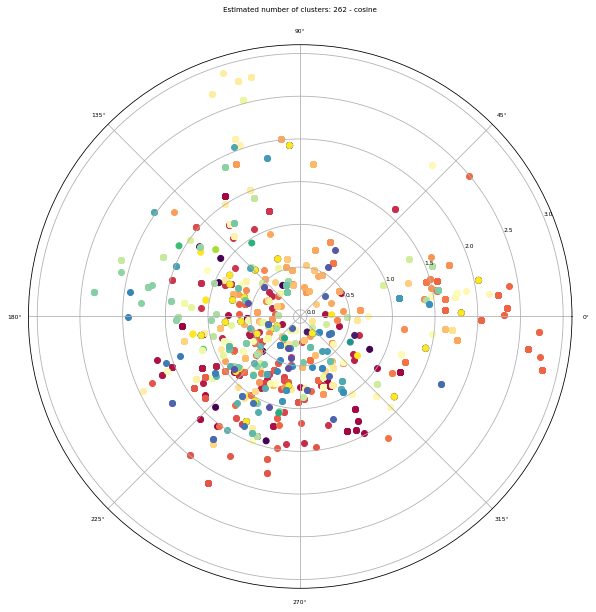

Metric: euclidean
Eps: 2.3
Min Samples: 2
Estimated number of clusters: 254
Estimated number of noise points: 393


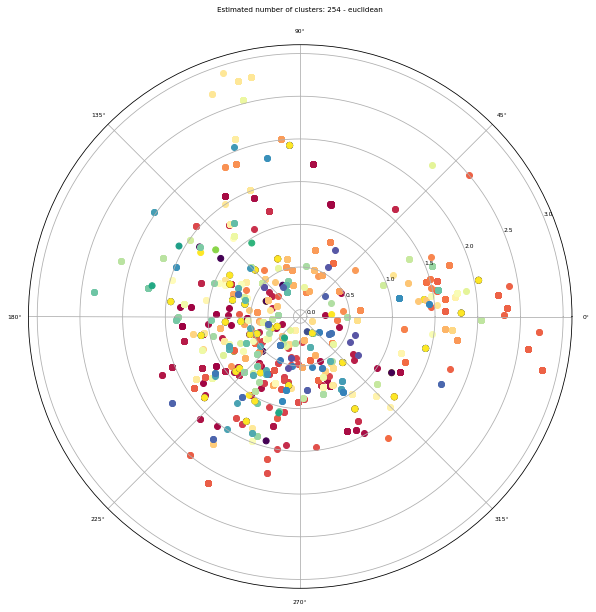

In [75]:
minSamples=[2]#[6,12,50,120]
eps = [0.12,2.3]#[0.15,0.17,0.19]#[0.80,0.81]#[0.3,0.5,0.75]

jsenemb = np.asarray(jsenemb)
mets = ['cosine','euclidean']#,'canberra','hamming']#'euclidean'#'cosine'
# #############################################################################
# Compute DBSCAN
for met in mets:
    print('Metric: %s' %met)
    for ep in eps:
        if (met == 'cosine' and ep != 2.3) or (met == 'euclidean' and ep != 0.12):
            print('Eps: {}'.format(ep))
            for minsample in minSamples:
                dbscan_model = DBSCAN(eps=ep, min_samples=minsample,metric=met)
                x = dbscan_model.fit(jsenemb)
                core_samples_mask = np.zeros_like(dbscan_model.labels_, dtype=bool)
                core_samples_mask[dbscan_model.core_sample_indices_] = True
                labels = dbscan_model.labels_

            # Number of clusters in labels, ignoring noise if present.
                n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
                n_noise_ = list(labels).count(-1)

                print('Min Samples: {}'.format(minsample))
                print('Estimated number of clusters: %d' % n_clusters_)
                print('Estimated number of noise points: %d' % n_noise_)

                #Calculation of Principal Component analysis
                pca = PCA(n_components=2).fit(jsenemb)
                datapoint = pca.transform(jsenemb)

                # Plot result
                # Black removed and is used for noise instead.
                unique_labels = set(labels)
                colors = [plt.cm.Spectral(each)
                          for each in np.linspace(0, 1, len(unique_labels))]

                fig = plt.figure(figsize=(20,10))
                ax= fig.add_subplot(111,projection='polar')

                for k, col in zip(unique_labels, colors):
                    if k == -1:
                        # Black used for noise.
                        col = [0, 0, 0, 1]

                    class_member_mask = (labels == k)

                    xy = datapoint[class_member_mask & core_samples_mask]
                    polars=[]
                    for point in xy:
                        polar = cart2pol(point[0], point[1])
                        polars.append(polar)

                    r=[]
                    theta=[]
                    for cp in polars:
                        r.append(cp[0])
                        theta.append(cp[1])

                    ax.set_rmax(0.012)
                    c = ax.scatter(theta, r,c=tuple(col),marker = 'o')
                    plt.rcParams.update({'font.size': 6})

    #                 xy = datapoint[class_member_mask & ~core_samples_mask]
    #                 polars=[]
    #                 for point in xy:
    #                     polar = cart2pol(point[0], point[1])
    #                     polars.append(polar)

    #                 r=[]
    #                 theta=[]
    #                 for cp in polars:
    #                     r.append(cp[0])
    #                     theta.append(cp[1])

    #                 cnp = ax.scatter(theta, r,c=tuple(col),marker=".")
    #                 plt.rcParams.update({'font.size': 2})

    #                 ax.legend(unique_labels)
                    fig.show()

    #             plt.margins(x=0, y=-0.45)   # Values in (-0.5, 0.0) zooms in to center

                plt.title('Estimated number of clusters: {} - {}'.format(n_clusters_,met))
                plt.show()

In [74]:
#Print lables and skills
len(labels)
for l in range(len(labels)):
    print("{}*{}*{}".format(l,jsenskill[l],labels[l]))

0*python*0
1*c++*1
2*opengl*2
3*computer vision*-1
4*algorithms*-1
5*computer science*3
6*machine learning*-1
7*data analysis*4
8*data visualization*-1
9*software design*5
10*science*3
11*computer graphics*-1
12*3d visualization*-1
13*big data*6
14*object oriented design*-1
15*shell scripting*7
16*web services*8
17*climate change*-1
18*web development*5
19*proposal writing*-1
20*social media*9
21*java*10
22*javascript*11
23*jquery ui*1
24*jquery*1
25*android*5
26*high performance computing*-1
27*parallel computing*-1
28*vtk*12
29*scientific computing*-1
30*cmake*2
31*mpi*2
32*qt*13
33*virtual reality*-1
34*opengl es*14
35*data science*15
36*geoprocessing*2
37*geovisualization*12
38*paraview*2
39*gdal*2
40*webgl*2
41*geographic information science*-1
42*scientific data management*16
43*data analytics*6
44*big data analytics*6
45*unix shell scripting*7
46*troubleshooting*17
47*security*18
48*software installation*19
49*electronics*-1
50*testing*20
51*technical support*21
52*software docu

1584*networking*40
1585*new business development*5
1586*business analysis*113
1587*analysis*113
1588*sdlc*115
1589*project management*45
1590*business requirements*146
1591*vendor management*117
1592*financial services*-1
1593*management*45
1594*banking*127
1595*requirements analysis*114
1596*requirements gathering*145
1597*data analysis*4
1598*software documentation*5
1599*business process improvement*108
1600*risk management*133
1601*pmo*102
1602*agile methodologies*116
1603*product management*184
1604*analytics*185
1605*portfolio management*45
1606*process improvement*108
1607*software project management*45
1608*project planning*52
1609*fixed income*-1
1610*integration*20
1611*strategy*69
1612*business intelligence*65
1613*quality assurance*134
1614*crm*71
1615*business process*108
1616*securities*-1
1617*systems analysis*209
1618*user acceptance testing*196
1619*project portfolio management*45
1620*equities*-1
1621*change management*53
1622*product development*74
1623*testing*20
16